# Problem 1: Image Classification on Imbalanced Dataset

## Q1: Prepare CIFAR-50 Dataset

Download dataset to your Google Drive from https://drive.google.com/drive/folders/1WGUKBP5Eta9DAltK1WtvRbX43iwP08DU?usp=sharing 

Unzip the files.

In [75]:
!pip install timm


[notice] A new release of pip is available: 23.0.1 -> 23.1.2
[notice] To update, run: pip install --upgrade pip


In [76]:
import torch
import torch.nn as nn
import torchvision
import timm
import matplotlib.pyplot as plt
import torch.utils.data as Data
from torch.autograd import Variable
import os

In [77]:
DOANLOAD_DATASET = True
LR = 0.001
BATCH_SIZE=128
EPOCH = 30
MODELS_PATH = './models'

Load and print label files to know the format of the provided labels.
- `cifar50_train.json`
- `cifar50_imbalance_0.02_train.json`

In [78]:
train_transform = torchvision.transforms.Compose([
    torchvision.transforms.RandomCrop(32, 4),
    torchvision.transforms.RandomHorizontalFlip(),
    torchvision.transforms.ToTensor(),
    torchvision.transforms.Normalize((.5, .5, .5), (.5, .5, .5))
])

test_transform = torchvision.transforms.Compose([
    torchvision.transforms.ToTensor(),
    torchvision.transforms.Normalize((.5, .5, .5), (.5, .5, .5))
])

train_data = torchvision.datasets.CIFAR10(
    root='./cifar10',
    train=True,
    transform=train_transform,
    download=DOANLOAD_DATASET
)

test_data = torchvision.datasets.CIFAR10(
    root='./cifar10',
    train=False,
    transform=test_transform,
    download=DOANLOAD_DATASET
)


  0%|          | 0/170498071 [00:00<?, ?it/s]

Extracting ./cifar10/cifar-10-python.tar.gz to ./cifar10
Files already downloaded and verified


Show some images with labels (class names) from dataset.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

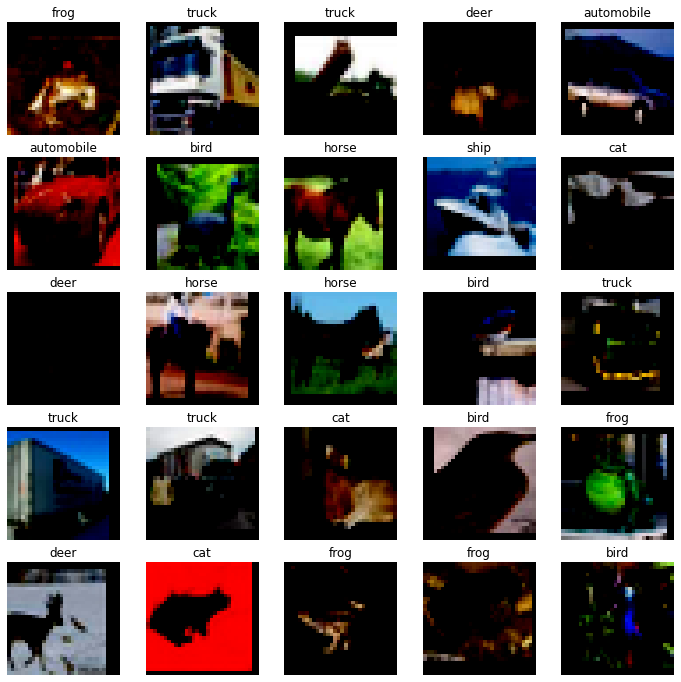

In [79]:
# todo: visualize some data with labels.
import numpy as np
import matplotlib.pyplot as plt
import cv2
from matplotlib import cm


lab_list = {0:'airplane', 1:'automobile', 2:'bird', 3:'cat', 4:'deer', 5:'dog', 6:'frog', 7:'horse', 8:'ship', 9:'truck'}

def cifar_imshow(path):
    img = cv2.imread(path)[:,:,::-1]
    return img

fig, axs = plt.subplots(5, 5, figsize = (12, 12))
plt.gray()

# loop through subplots and add mnist images
for i, ax in enumerate(axs.flat):
    ax.imshow(train_data[i][0].permute(1,2,0).cpu().detach().numpy(), cmap=cm.gray_r)
    ax.axis('off')
    ax.set_title('{}'.format(lab_list[train_data[i][1]]))



## Q2: Train CNNs.

#### Use the CNN in HW2 to train the model on the balanced CIFAR50 dataset.

Train the CNN on the balanced CIFAR50 training set. Evaluate and report the classification accuracies on the testing set. 

Note: You can use any network configurations you implemented in HW2.

In [80]:
from tqdm.notebook import tqdm
import pickle
import torch.nn as nn
import torch.nn.functional as F
from torch import Tensor
import torch
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

def mixup_data(x, y, alpha=1.0):
    lam = np.random.beta(alpha, alpha)
    batch_size = x.size()[0]
    index = torch.randperm(batch_size)
    mixed_x = lam * x + (1 - lam) * x[index, :]
    y_a, y_b = y, y[index]
    return mixed_x, y_a, y_b, lam
    
def mixup_criterion(pred, y_a, y_b, lam):
    criterion = nn.CrossEntropyLoss()
    return lam * criterion(pred, y_a) + (1 - lam) * criterion(pred, y_b)

def save_checkpoint(model, optimizer, epoch, name='MLP'):
    state_dic = model.state_dict()

    config = {
        "model_state_dict": state_dic,
        "optim_state_dict": optimizer.state_dict(),
        "epoch" : epoch
    }
    if name==None:
        with open(name + '.pickle', "wb") as f:
            pickle.dump(config, f)
    else:
        with open(name + '.pickle', "wb") as f:
            pickle.dump(config, f)

class AverageMeter(object):
    def __init__(self):
        self.reset()

    def reset(self):
        self.val = 0
        self.avg = 0
        self.sum = 0
        self.count = 0

    def update(self, val, n=1):
        self.val = val
        self.sum += val * n
        self.count += n
        self.avg = self.sum / self.count

class Training():
    def __init__(self,train_loader, val_loader, model, criterion, optimizer, device, scaler, scheduler, name):
        self.train_loader = train_loader
        self.val_loader = val_loader
        self.model = model
        self.criterion = criterion
        self.optimizer = optimizer
        self.device = device
        self.scaler = scaler
        self.scheduler = scheduler
        self.epoch = 0
        self.bast_acc = -1
        self.name = name
        self.mixup = False


    def train(self, epoch):
        losses = AverageMeter()
        correct = 0
        totle = 0
        self.model.train()

        self.train_loader = tqdm(self.train_loader)

        for idx, (image,target) in enumerate(self.train_loader):
            image = image.to(self.device, non_blocking=True)
            target = target.to(self.device, non_blocking=True)

            if self.mixup:
                image, targets_a, targets_b, lam = mixup_data(image, target, 0.1)
                image, targets_a, targets_b = image.cuda(), targets_a.cuda(), targets_b.cuda()

            self.optimizer.zero_grad()
            with torch.cuda.amp.autocast():
                output = self.model(image)
                if self.mixup:
                    loss = mixup_criterion(output, targets_a, targets_b, lam)
                else:
                   loss = self.criterion(output, target)

            losses.update(float(loss), image.size(0))
            pred = torch.max(output.data, 1)[1]
            correct += (pred == target).sum().item()
            totle += image.size(0)

            self.scaler.scale(loss).backward()
            self.scaler.step(self.optimizer)
            self.scaler.update()
        if self.scheduler != None:
            self.scheduler.step()
        print('Loss:', round(losses.avg, 3), 'Acc:', round(correct / totle, 3))

    def validate(self, epoch):
        losses = AverageMeter()
        correct = 0
        totle = 0
        self.val_loader = tqdm(self.val_loader)
        self.model.eval()
        with torch.no_grad():
            for idx, (image,target) in enumerate(self.val_loader):
                image = image.to(self.device, non_blocking=True)
                target = target.to(self.device, non_blocking=True)
                output = self.model(image)
                loss = self.criterion(output, target)

                losses.update(float(loss), image.size(0))
                pred = torch.max(output.data, 1)[1]
                correct += (pred == target).sum().item()
                totle += image.size(0)
        acc = round(correct/totle, 5)
        save_checkpoint(self.model, self.optimizer, epoch, self.name)# + '_' + str(acc)
        if acc > self.bast_acc:
            self.bast_acc = acc
        print('Loss:', round(losses.avg,4),'Acc:',acc)
        print('-----------------------------------------------------------------------------------------------------')


In [81]:
import torchvision
import random
from torch.utils.data import Dataset, DataLoader
import numpy as np
from PIL import Image

class Cifar10Imbanlance(Dataset):
    def __init__(self, imbanlance_rate, num_cls=10, file_path="data/",
                 train=True, transform=None, label_align=True, ):
        self.transform = transform
        self.label_align = label_align
        assert 0.0 < imbanlance_rate < 1, "imbanlance_rate must 0.0 < imbanlance_rate < 1"
        self.imbanlance_rate = imbanlance_rate

        self.num_cls = num_cls
        self.data = self.produce_imbanlance_data(file_path=file_path, train=train,imbanlance_rate=self.imbanlance_rate)
        self.x = self.data['x']
        self.targets = self.data['y'].tolist()
        self.y = self.data['y'].tolist()

    def __len__(self):
        return len(self.x)

    def __getitem__(self, item):
        x, y = self.x[item], self.y[item]
        x = Image.fromarray(x)
        if self.transform is not None:
            x = self.transform(x)
        return x, y

    def get_per_class_num(self):
        return self.class_list

    def produce_imbanlance_data(self, imbanlance_rate, file_path="/data", train=True):

        train_data = torchvision.datasets.CIFAR10(
            root=file_path,
            train=train,
            download=True,
        )
        x_train = train_data.data
        y_train = train_data.targets
        y_train = np.array(y_train)

        rehearsal_data = None
        rehearsal_label = None

        data_percent = []
        data_num = int(x_train.shape[0] / self.num_cls)

        for cls_idx in range(self.num_cls):
            if train:
                num = data_num * (imbanlance_rate ** (cls_idx / (self.num_cls - 1)))
                data_percent.append(int(num))
            else:
                num = data_num
                data_percent.append(int(num))
        if train:
            print("imbanlance_ration is {}".format(data_percent[0] / data_percent[-1]))
            print("per class num: {}".format(data_percent))

        self.class_list = data_percent



        for i in range(1, self.num_cls + 1):
            a1 = y_train >= i - 1
            a2 = y_train < i
            index = a1 & a2
            task_train_x = x_train[index]
            label = y_train[index]
            data_num = task_train_x.shape[0]
            index = np.random.choice(data_num, data_percent[i - 1])
            tem_data = task_train_x[index]
            tem_label = label[index]
            if rehearsal_data is None:
                rehearsal_data = tem_data
                rehearsal_label = tem_label
            else:
                rehearsal_data = np.concatenate([rehearsal_data, tem_data], axis=0)
                rehearsal_label = np.concatenate([rehearsal_label, tem_label], axis=0)

        task_split = {
            "x": rehearsal_data,
            "y": rehearsal_label,
        }
        return task_split

In [82]:


class CNN(nn.Module):
  def __init__(self):
    super().__init__()

    self.conv1 = nn.Conv2d(3, 64, padding=1,kernel_size=3, stride=1)
    self.conv2 = nn.Conv2d(64, 64, padding=1,kernel_size=3, stride=1)

    self.bat1 = nn.BatchNorm2d(64)
    self.conv3 = nn.Conv2d(64, 128, kernel_size=3, stride=1)
    self.conv4 = nn.Conv2d(128, 128, kernel_size=3, stride=1)

    self.bat2 = nn.BatchNorm2d(128)
    self.conv5 = nn.Conv2d(128, 256, kernel_size=3, stride=1)
    self.conv6 = nn.Conv2d(256, 256, kernel_size=3, stride=1)

    self.bat3 = nn.BatchNorm2d(256)
    self.flatten = nn.Flatten()
    self.fc1 = nn.Linear(147456, 120)
    self.bat6 = nn.BatchNorm1d(120)
    self.fc2 = nn.Linear(120, 84)
    self.bat7 = nn.BatchNorm1d(84)
    self.fc3 = nn.Linear(84, 10)
    
    

  def forward(self, x):

    x = F.relu(self.conv1(x))
    x = F.relu(self.conv2(x))

    x = self.bat1(x)
    x = F.relu(self.conv3(x))
    x = F.relu(self.conv4(x))

    x = self.bat2(x)
    x = F.relu(self.conv5(x))
    x = F.relu(self.conv6(x))

    x = self.flatten(x)

    x = F.relu(self.fc1(x))
    x = self.bat6(x)
    x = F.relu(self.fc2(x))
    x = self.bat7(x)
    x = self.fc3(x)

    return x

In [83]:
# todo
import torch.optim as optim

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

net = CNN().to(device)
criterion = nn.CrossEntropyLoss()
optimizer = optim.AdamW(net.parameters(), lr=0.001, betas=(0.9, 0.999), eps=1e-08, weight_decay=0)

train_dataloader = DataLoader(train_data, batch_size=256, shuffle=False)
val_dataloader = DataLoader(test_data, batch_size=256, shuffle=False)

In [84]:
# todo
n_epoch = 30
scaler = torch.cuda.amp.GradScaler()
scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.96)
T = Training(train_dataloader, val_dataloader, net, criterion, optimizer, device, scaler, scheduler,'NET1')
for epoch in range(n_epoch):
    T.train(epoch)
    T.validate(epoch)

  0%|          | 0/196 [00:00<?, ?it/s]

Loss: 1.491 Acc: 0.458


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 1.187 Acc: 0.5688
-----------------------------------------------------------------------------------------------------


  0%|          | 0/196 [00:00<?, ?it/s]

Loss: 1.072 Acc: 0.615


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.9433 Acc: 0.666
-----------------------------------------------------------------------------------------------------


  0%|          | 0/196 [00:00<?, ?it/s]

Loss: 0.86 Acc: 0.695


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.8457 Acc: 0.7113
-----------------------------------------------------------------------------------------------------


  0%|          | 0/196 [00:00<?, ?it/s]

Loss: 0.751 Acc: 0.737


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 1.0935 Acc: 0.7422
-----------------------------------------------------------------------------------------------------


  0%|          | 0/196 [00:00<?, ?it/s]

Loss: 0.675 Acc: 0.763


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.7371 Acc: 0.7591
-----------------------------------------------------------------------------------------------------


  0%|          | 0/196 [00:00<?, ?it/s]

Loss: 0.616 Acc: 0.783


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.6239 Acc: 0.7828
-----------------------------------------------------------------------------------------------------


  0%|          | 0/196 [00:00<?, ?it/s]

Loss: 0.559 Acc: 0.805


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.6427 Acc: 0.7952
-----------------------------------------------------------------------------------------------------


  0%|          | 0/196 [00:00<?, ?it/s]

Loss: 0.518 Acc: 0.819


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.5386 Acc: 0.8153
-----------------------------------------------------------------------------------------------------


  0%|          | 0/196 [00:00<?, ?it/s]

Loss: 0.477 Acc: 0.835


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.5166 Acc: 0.8216
-----------------------------------------------------------------------------------------------------


  0%|          | 0/196 [00:00<?, ?it/s]

Loss: 0.445 Acc: 0.845


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.5102 Acc: 0.8312
-----------------------------------------------------------------------------------------------------


  0%|          | 0/196 [00:00<?, ?it/s]

Loss: 0.411 Acc: 0.858


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.4839 Acc: 0.837
-----------------------------------------------------------------------------------------------------


  0%|          | 0/196 [00:00<?, ?it/s]

Loss: 0.386 Acc: 0.867


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.4953 Acc: 0.837
-----------------------------------------------------------------------------------------------------


  0%|          | 0/196 [00:00<?, ?it/s]

Loss: 0.357 Acc: 0.877


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.4766 Acc: 0.8428
-----------------------------------------------------------------------------------------------------


  0%|          | 0/196 [00:00<?, ?it/s]

Loss: 0.336 Acc: 0.884


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.5116 Acc: 0.8364
-----------------------------------------------------------------------------------------------------


  0%|          | 0/196 [00:00<?, ?it/s]

Loss: 0.313 Acc: 0.892


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.5043 Acc: 0.836
-----------------------------------------------------------------------------------------------------


  0%|          | 0/196 [00:00<?, ?it/s]

Loss: 0.291 Acc: 0.9


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.5421 Acc: 0.8414
-----------------------------------------------------------------------------------------------------


  0%|          | 0/196 [00:00<?, ?it/s]

Loss: 0.276 Acc: 0.906


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.4659 Acc: 0.8475
-----------------------------------------------------------------------------------------------------


  0%|          | 0/196 [00:00<?, ?it/s]

Loss: 0.256 Acc: 0.912


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.5482 Acc: 0.8531
-----------------------------------------------------------------------------------------------------


  0%|          | 0/196 [00:00<?, ?it/s]

Loss: 0.24 Acc: 0.918


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.5603 Acc: 0.8385
-----------------------------------------------------------------------------------------------------


  0%|          | 0/196 [00:00<?, ?it/s]

Loss: 0.222 Acc: 0.923


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.4217 Acc: 0.8682
-----------------------------------------------------------------------------------------------------


  0%|          | 0/196 [00:00<?, ?it/s]

Loss: 0.208 Acc: 0.929


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.4806 Acc: 0.8623
-----------------------------------------------------------------------------------------------------


  0%|          | 0/196 [00:00<?, ?it/s]

Loss: 0.192 Acc: 0.934


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.4745 Acc: 0.8536
-----------------------------------------------------------------------------------------------------


  0%|          | 0/196 [00:00<?, ?it/s]

Loss: 0.176 Acc: 0.94


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.4838 Acc: 0.8535
-----------------------------------------------------------------------------------------------------


  0%|          | 0/196 [00:00<?, ?it/s]

Loss: 0.163 Acc: 0.944


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.4343 Acc: 0.8675
-----------------------------------------------------------------------------------------------------


  0%|          | 0/196 [00:00<?, ?it/s]

Loss: 0.153 Acc: 0.947


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.4695 Acc: 0.8639
-----------------------------------------------------------------------------------------------------


  0%|          | 0/196 [00:00<?, ?it/s]

Loss: 0.14 Acc: 0.952


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.4715 Acc: 0.8645
-----------------------------------------------------------------------------------------------------


  0%|          | 0/196 [00:00<?, ?it/s]

Loss: 0.128 Acc: 0.956


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.462 Acc: 0.8665
-----------------------------------------------------------------------------------------------------


  0%|          | 0/196 [00:00<?, ?it/s]

Loss: 0.121 Acc: 0.959


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.4793 Acc: 0.8661
-----------------------------------------------------------------------------------------------------


  0%|          | 0/196 [00:00<?, ?it/s]

Loss: 0.113 Acc: 0.962


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.4958 Acc: 0.8624
-----------------------------------------------------------------------------------------------------


  0%|          | 0/196 [00:00<?, ?it/s]

Loss: 0.1 Acc: 0.966


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.5122 Acc: 0.8605
-----------------------------------------------------------------------------------------------------


#### Use the same CNN above to train the model on the imbalanced CIFAR50 dataset.

Train the CNN on the imbalanced CIFAR50 training set. Evaluate and report the classification accuracies on the testing set. 


In [85]:
# todo
import torch.optim as optim


device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# net = timm.create_model('mobilenetv3_large_100', pretrained=False, num_classes=10).to(device)
net = CNN().to(device)
criterion = nn.CrossEntropyLoss()
optimizer = optim.AdamW(net.parameters(), lr=0.001, betas=(0.9, 0.999), eps=1e-08, weight_decay=0)

train_imdata = Cifar10Imbanlance(imbanlance_rate=0.2, train=True, transform=train_transform)
test_imdata = Cifar10Imbanlance(imbanlance_rate=0.99,train=False, transform=test_transform)

train_dataloader = DataLoader(train_imdata, batch_size=256, shuffle=False)
val_dataloader = DataLoader(test_imdata, batch_size=256, shuffle=False)

n_epoch = 30
scaler = torch.cuda.amp.GradScaler()
scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.96)
T = Training(train_dataloader, val_dataloader, net, criterion, optimizer, device, scaler, scheduler,'NET1')
for epoch in range(n_epoch):
    T.train(epoch)
    T.validate(epoch)

  0%|          | 0/170498071 [00:00<?, ?it/s]

Extracting data/cifar-10-python.tar.gz to data/
imbanlance_ration is 5.0
per class num: [5000, 4181, 3496, 2924, 2445, 2044, 1709, 1429, 1195, 1000]
Files already downloaded and verified


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 2.341 Acc: 0.1


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 2.3093 Acc: 0.1199
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 2.301 Acc: 0.192


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 2.2897 Acc: 0.0871
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 2.288 Acc: 0.225


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 2.2783 Acc: 0.0874
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 2.276 Acc: 0.226


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 2.2776 Acc: 0.0908
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 2.267 Acc: 0.225


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 2.2907 Acc: 0.0824
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 2.259 Acc: 0.219


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 2.2946 Acc: 0.0863
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 2.252 Acc: 0.223


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 2.2943 Acc: 0.0906
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 2.247 Acc: 0.225


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 2.2939 Acc: 0.0898
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 2.242 Acc: 0.221


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 2.315 Acc: 0.0892
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 2.238 Acc: 0.219


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 2.3086 Acc: 0.0949
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 2.235 Acc: 0.212


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 2.3236 Acc: 0.0926
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 2.231 Acc: 0.214


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 2.3121 Acc: 0.0947
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 2.228 Acc: 0.212


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 2.3142 Acc: 0.0924
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 2.226 Acc: 0.211


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 2.3167 Acc: 0.0953
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 2.223 Acc: 0.207


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 2.3273 Acc: 0.0955
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 2.221 Acc: 0.21


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 2.3415 Acc: 0.0996
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 2.219 Acc: 0.204


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 2.3287 Acc: 0.0953
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 2.217 Acc: 0.202


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 2.3251 Acc: 0.0955
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 2.215 Acc: 0.201


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 2.3313 Acc: 0.1006
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 2.213 Acc: 0.203


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 2.35 Acc: 0.1003
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 2.212 Acc: 0.204


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 2.3367 Acc: 0.1016
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 2.211 Acc: 0.193


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 2.338 Acc: 0.0993
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 2.209 Acc: 0.199


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 2.34 Acc: 0.1021
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 2.208 Acc: 0.193


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 2.3262 Acc: 0.1031
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 2.206 Acc: 0.199


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 2.3364 Acc: 0.1032
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 2.205 Acc: 0.195


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 2.3327 Acc: 0.1037
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 2.204 Acc: 0.194


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 2.3348 Acc: 0.1047
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 2.203 Acc: 0.194


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 2.3287 Acc: 0.1022
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 2.202 Acc: 0.199


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 2.3289 Acc: 0.1055
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 2.202 Acc: 0.192


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 2.3401 Acc: 0.0981
-----------------------------------------------------------------------------------------------------


## Implement Tricks for LTR

Before starting this question, please read the paper on Canvas: Bag of tricks for long-tailed visual recognition with deep convolutional neural networks.

According to this paper, select at least **three** tricks to implement on the imbalanced CIFAR50 training. 

Trick 1

In [86]:
# todo
import torch.optim as optim


device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# net = timm.create_model('mobilenetv3_large_100', pretrained=False, num_classes=10).to(device)
net = CNN().to(device)
criterion = nn.CrossEntropyLoss()
optimizer = optim.AdamW(net.parameters(), lr=0.001, betas=(0.9, 0.999), eps=1e-08, weight_decay=0)

train_imdata = Cifar10Imbanlance(imbanlance_rate=0.2, train=True, transform=train_transform)
test_imdata = Cifar10Imbanlance(imbanlance_rate=0.99,train=False, transform=test_transform)

train_dataloader = DataLoader(train_imdata, batch_size=256, shuffle=True)
val_dataloader = DataLoader(test_imdata, batch_size=256, shuffle=True)

n_epoch = 1
scaler = torch.cuda.amp.GradScaler()
scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.96)
T = Training(train_dataloader, val_dataloader, net, criterion, optimizer, device, scaler, scheduler,'NET1')

for epoch in range(n_epoch):
    T.train(epoch)
    T.validate(epoch)

Files already downloaded and verified
imbanlance_ration is 5.0
per class num: [5000, 4181, 3496, 2924, 2445, 2044, 1709, 1429, 1195, 1000]
Files already downloaded and verified


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 1.613 Acc: 0.429


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 2.0475 Acc: 0.3665
-----------------------------------------------------------------------------------------------------


Trick 2

In [87]:
# todo
import torch.optim as optim
from torch.utils.data import WeightedRandomSampler

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# net = timm.create_model('mobilenetv3_large_100', pretrained=False, num_classes=10).to(device)
net = CNN().to(device)
criterion = nn.CrossEntropyLoss()
optimizer = optim.AdamW(net.parameters(), lr=0.001, betas=(0.9, 0.999), eps=1e-08, weight_decay=0)

train_imdata = Cifar10Imbanlance(imbanlance_rate=0.2, train=True, transform=train_transform)
test_imdata = Cifar10Imbanlance(imbanlance_rate=0.99,train=False, transform=test_transform)


target = train_imdata.targets
class_sample_count = np.array(train_imdata.get_per_class_num())
weight = 1. / class_sample_count
samples_weight = np.array([weight[t] for t in target])
samples_weight = torch.from_numpy(samples_weight)
samples_weight = samples_weight.double()
sampler = WeightedRandomSampler(samples_weight, len(samples_weight))


train_dataloader = DataLoader(train_imdata, batch_size=256, shuffle=False, sampler=sampler)
val_dataloader = DataLoader(test_imdata, batch_size=256, shuffle=True)

n_epoch = 30
scaler = torch.cuda.amp.GradScaler()
scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.96)
T = Training(train_dataloader, val_dataloader, net, criterion, optimizer, device, scaler, scheduler,'NET1')

for epoch in range(n_epoch):
    T.train(epoch)
    T.validate(epoch)




Files already downloaded and verified
imbanlance_ration is 5.0
per class num: [5000, 4181, 3496, 2924, 2445, 2044, 1709, 1429, 1195, 1000]
Files already downloaded and verified


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 1.665 Acc: 0.39


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 1.5041 Acc: 0.4513
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 1.345 Acc: 0.51


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 1.2391 Acc: 0.5583
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 1.139 Acc: 0.593


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 1.0795 Acc: 0.6116
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.971 Acc: 0.653


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 1.0008 Acc: 0.6361
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.868 Acc: 0.688


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.853 Acc: 0.7042
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.788 Acc: 0.718


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 1.1382 Acc: 0.6463
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.723 Acc: 0.743


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.8425 Acc: 0.7229
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.669 Acc: 0.763


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 1.0731 Acc: 0.7092
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.605 Acc: 0.791


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.8925 Acc: 0.7322
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.576 Acc: 0.798


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.7923 Acc: 0.7304
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.525 Acc: 0.819


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.8612 Acc: 0.7241
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.492 Acc: 0.829


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.733 Acc: 0.7537
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.436 Acc: 0.85


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.7648 Acc: 0.7581
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.431 Acc: 0.85


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.9157 Acc: 0.7273
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.39 Acc: 0.865


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.712 Acc: 0.775
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.352 Acc: 0.88


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.7334 Acc: 0.7689
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.335 Acc: 0.884


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.7834 Acc: 0.7631
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.295 Acc: 0.9


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.7545 Acc: 0.767
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.278 Acc: 0.905


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.6721 Acc: 0.7916
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.267 Acc: 0.91


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.7291 Acc: 0.7769
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.241 Acc: 0.919


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.7161 Acc: 0.7835
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.224 Acc: 0.925


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.7334 Acc: 0.7841
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.21 Acc: 0.93


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.6993 Acc: 0.8001
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.179 Acc: 0.94


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.7645 Acc: 0.784
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.17 Acc: 0.943


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.6875 Acc: 0.8
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.156 Acc: 0.949


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.712 Acc: 0.7954
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.144 Acc: 0.953


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.7206 Acc: 0.7951
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.135 Acc: 0.956


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.7208 Acc: 0.8043
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.124 Acc: 0.961


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.7211 Acc: 0.799
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.115 Acc: 0.962


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.7813 Acc: 0.793
-----------------------------------------------------------------------------------------------------


Trick 3

In [88]:
# todo
import torch.optim as optim
from torch.utils.data import WeightedRandomSampler

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# net = timm.create_model('mobilenetv3_large_100', pretrained=False, num_classes=10).to(device)
net = CNN().to(device)
criterion = nn.CrossEntropyLoss()
optimizer = optim.AdamW(net.parameters(), lr=0.001, betas=(0.9, 0.999), eps=1e-08, weight_decay=0)

train_imdata = Cifar10Imbanlance(imbanlance_rate=0.2, train=True, transform=train_transform)
test_imdata = Cifar10Imbanlance(imbanlance_rate=0.99,train=False, transform=test_transform)


target = train_imdata.targets
class_sample_count = np.array(train_imdata.get_per_class_num())
weight = 1. / class_sample_count
samples_weight = np.array([weight[t] for t in target])
samples_weight = torch.from_numpy(samples_weight)
samples_weight = samples_weight.double()
sampler = WeightedRandomSampler(samples_weight, len(samples_weight))


train_dataloader = DataLoader(train_imdata, batch_size=256, shuffle=False, sampler=sampler)
val_dataloader = DataLoader(test_imdata, batch_size=256, shuffle=True)

n_epoch = 30
scaler = torch.cuda.amp.GradScaler()
scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.96)
T = Training(train_dataloader, val_dataloader, net, criterion, optimizer, device, scaler, scheduler,'NET1')
T.mixup = True
for epoch in range(n_epoch):
    T.train(epoch)
    T.validate(epoch)


Files already downloaded and verified
imbanlance_ration is 5.0
per class num: [5000, 4181, 3496, 2924, 2445, 2044, 1709, 1429, 1195, 1000]
Files already downloaded and verified


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 1.746 Acc: 0.23


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 1.5698 Acc: 0.4274
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 1.495 Acc: 0.33


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 1.2785 Acc: 0.5371
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 1.266 Acc: 0.293


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 1.1635 Acc: 0.5814
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 1.162 Acc: 0.37


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 1.1394 Acc: 0.5923
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 1.069 Acc: 0.412


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 1.1518 Acc: 0.6663
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.978 Acc: 0.408


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.8585 Acc: 0.7047
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.903 Acc: 0.419


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 1.2097 Acc: 0.6995
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.893 Acc: 0.42


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.867 Acc: 0.7124
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.846 Acc: 0.489


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.8638 Acc: 0.715
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.795 Acc: 0.469


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.7522 Acc: 0.7401
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.776 Acc: 0.449


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.8003 Acc: 0.7416
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.771 Acc: 0.471


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.6516 Acc: 0.7774
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.772 Acc: 0.443


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.7443 Acc: 0.7615
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.705 Acc: 0.49


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.659 Acc: 0.78
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.71 Acc: 0.383


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.6953 Acc: 0.7721
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.601 Acc: 0.493


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.6954 Acc: 0.7661
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.684 Acc: 0.445


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.6485 Acc: 0.7856
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.633 Acc: 0.404


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.61 Acc: 0.7964
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.526 Acc: 0.544


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.6023 Acc: 0.7983
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.642 Acc: 0.446


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.5934 Acc: 0.8059
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.565 Acc: 0.572


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.6259 Acc: 0.791
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.468 Acc: 0.519


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.6003 Acc: 0.8047
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.506 Acc: 0.542


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.585 Acc: 0.805
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.534 Acc: 0.515


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.6176 Acc: 0.8
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.468 Acc: 0.485


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.6631 Acc: 0.7854
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.513 Acc: 0.468


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.5747 Acc: 0.8157
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.442 Acc: 0.396


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.5858 Acc: 0.8069
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.431 Acc: 0.596


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.5821 Acc: 0.8106
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.461 Acc: 0.481


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.5862 Acc: 0.8107
-----------------------------------------------------------------------------------------------------


  0%|          | 0/100 [00:00<?, ?it/s]

Loss: 0.419 Acc: 0.505


  0%|          | 0/40 [00:00<?, ?it/s]

Loss: 0.6372 Acc: 0.7881
-----------------------------------------------------------------------------------------------------


Paste performance above to this table

|          | Baseline | Trick1 |Trick2| Trick|
|----------|:-----:|:-----------:|:-----------:|:-----------:|
| Test Accuracy (%) | 0.0981 | 0.3665 | 0.793 | 0.7881 |

# Problem 2: Transfer Learning and Domain Adaptation

The goal of domain adaptation is to transfer the knowledge of a model to a different but related data distribution. The model is trained on a source dataset and applied to a target dataset (usually unlabeled). For Problem 3, the model will be trained on regular MNIST images, but we want to get good performance on MNIST with random color (without any labels).


**Problem Statement** Given a labelled source domain (MNIST) and an unlabelled target domain (MNIST-M). We would like to train a classifier or a predictor which would give accurate predictions on the target domain. 

**Assumptions** Probability distribution of source domain is not equal to the probability distribution of target domain. The conditional probability distribution of the labels given an instance from the source domain is equal to the conditional probability distribution of the labels given an instance from the target domain. Source dataset is labelled. Target dataset is unlabelled.

**Approach** Here, we adopt the DABP method mentioned in the paper “Unsupervised Domain Adaptation by Backpropagation”.

* Feature Extractor (green): This is a neural network that will learn to perform the transformation on the source and target distribution. 
* Label Classifier (blue): This is a neural network that will learn to perform the classification on the transformed source distribution. Since, the source domain is labelled. 
* Domain Classifier (red): This is a neural network that will predict whether the output of the Feature Extractor is from the source distribution or the target distribution.



By using the above three components, the Feature Extractor will learn to produce discriminative and domain-invariant features. 

In [ ]:
# download the codes from Git
!git clone https://github.com/Haotian-Zhang/Pytorch_DABP.git

Train the DABP model by running `main.py` and answer the following questions. 


* Q1: Perform **3** experiments on training and report your source and target accuracy in the tables below. (Your result is the average of the Target Accs. based on 3 experiments)

**Source Only**

|                | Test1 | Test2 | Test3 |
|----------------|:-----:|:-----:|:-----:|
| Source Acc (%) |   99.28 |    99.25   |   98.98    |
| Target Acc (%) |   64.10 |    64.25   |   63.89   |

|          | Paper | Your Result |
|----------|:-----:|:-----------:|
| DABP (%) | 52.25 |     64.08     |

**DANN**

|                | Test1 | Test2 | Test3 |
|----------------|:-----:|:-----:|:-----:|
| Source Acc (%) |  99.08  |   98.89    |  99.02      |
| Target Acc (%) |  79.33 |   78.98    |     79.23  |

|          | Paper | Your Result |
|----------|:-----:|:-----------:|
| DABP (%) | 76.66 |     79.13     |



In [1]:
!python Pytorch_DABP/main.py

Running GPU : 0
Source-only training
Epoch : 0
/home/student/Desktop/HW3/Pytorch_DABP/model.py:38: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  return F.softmax(x)
[1568/60000 (3%)]	Class Loss: 2.298062
[3168/60000 (6%)]	Class Loss: 2.302490
[4768/60000 (9%)]	Class Loss: 2.301498
[6368/60000 (12%)]	Class Loss: 2.296191
[7968/60000 (14%)]	Class Loss: 2.280807
[9568/60000 (17%)]	Class Loss: 2.221954
[11168/60000 (20%)]	Class Loss: 1.977708
[12768/60000 (23%)]	Class Loss: 1.775743
[14368/60000 (26%)]	Class Loss: 1.739958
[15968/60000 (29%)]	Class Loss: 1.601056
[17568/60000 (32%)]	Class Loss: 1.565160
[19168/60000 (35%)]	Class Loss: 1.576910
[20768/60000 (38%)]	Class Loss: 1.550617
[22368/60000 (41%)]	Class Loss: 1.504837
[23968/60000 (44%)]	Class Loss: 1.495615
[25568/60000 (46%)]	Class Loss: 1.615758
[27168/60000 (49%)]	Class Loss: 1.522624
[28768/60000 (52%)]	Class Loss: 1.502036
[30368/60000 (55%)]	Class Los

* Q2: Write your own codes to visualize the feature space by using the TSNE(perplexity=30, n_components=2, init=’pca’, n_iter=3000). Plot the feature distributions for both (1) original MNIST and MNIST-M inputs and (2) after DABP using source only (3) after DABP using dann.(**You will find useful functions inside the `utils`function.** )

(1) Original MNIST and MNIST-M inputs

  0%|          | 0/9912422 [00:00<?, ?it/s]

Extracting data/pytorch/MNIST/MNIST/raw/train-images-idx3-ubyte.gz to data/pytorch/MNIST/MNIST/raw



  0%|          | 0/28881 [00:00<?, ?it/s]

Extracting data/pytorch/MNIST/MNIST/raw/train-labels-idx1-ubyte.gz to data/pytorch/MNIST/MNIST/raw



  0%|          | 0/1648877 [00:00<?, ?it/s]

Extracting data/pytorch/MNIST/MNIST/raw/t10k-images-idx3-ubyte.gz to data/pytorch/MNIST/MNIST/raw



  0%|          | 0/4542 [00:00<?, ?it/s]

Extracting data/pytorch/MNIST/MNIST/raw/t10k-labels-idx1-ubyte.gz to data/pytorch/MNIST/MNIST/raw

Processing...


  0%|          | 0/9912422 [00:00<?, ?it/s]

Extracting data/MNIST/raw/train-images-idx3-ubyte.gz to data/MNIST/raw



  0%|          | 0/28881 [00:00<?, ?it/s]

Extracting data/MNIST/raw/train-labels-idx1-ubyte.gz to data/MNIST/raw



  0%|          | 0/1648877 [00:00<?, ?it/s]

Extracting data/MNIST/raw/t10k-images-idx3-ubyte.gz to data/MNIST/raw



  0%|          | 0/4542 [00:00<?, ?it/s]

Extracting data/MNIST/raw/t10k-labels-idx1-ubyte.gz to data/MNIST/raw



/home/student/anaconda3/envs/ML/lib/python3.8/site-packages/torchvision/datasets/mnist.py:65: UserWarning: train_labels has been renamed targets
  warnings.warn("train_labels has been renamed targets")
/home/student/anaconda3/envs/ML/lib/python3.8/site-packages/torchvision/datasets/mnist.py:70: UserWarning: test_labels has been renamed targets
  warnings.warn("test_labels has been renamed targets")


MNISTM Done!
Extract features to draw T-SNE plot...


/home/student/anaconda3/envs/ML/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
/home/student/anaconda3/envs/ML/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:991: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


Draw plot ...
saved_plot/input_mnist_n_mnistM.png is saved


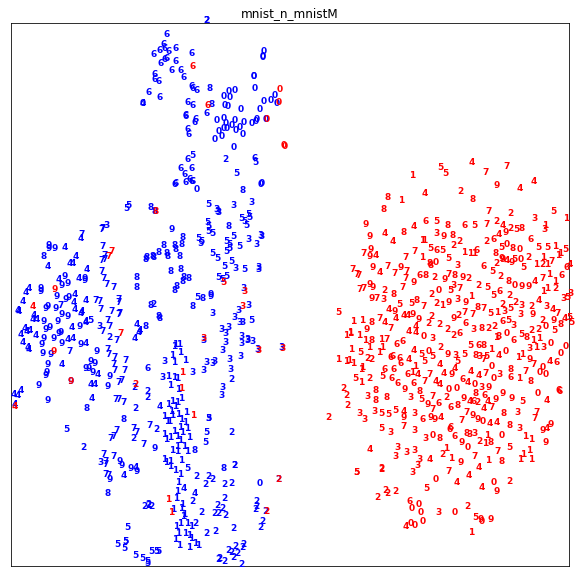

In [8]:
# todo
import os
os.chdir('Pytorch_DABP')
from utils import *

visualize_input()

(2) After DABP using source only

Running GPU : 0
Extract features to draw T-SNE plot...


/home/student/anaconda3/envs/ML/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
/home/student/anaconda3/envs/ML/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:991: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


Draw plot ...
saved_plot/test_None_test.png is saved


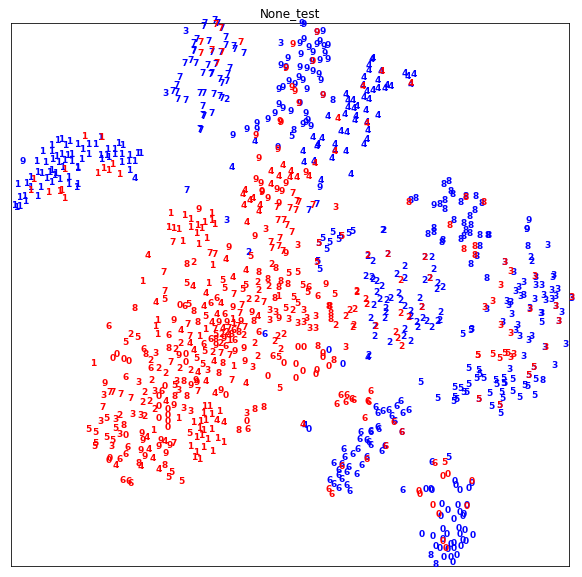

In [12]:
# todo
# todo
from mnistm import *
import model
import torch

def main():
    source_train_loader = mnist.mnist_train_loader
    target_train_loader = mnistm.mnistm_train_loader

    if torch.cuda.is_available():
        print('Running GPU : {}'.format(torch.cuda.current_device()))
        encoder = model.Extractor().cuda()
        classifier = model.Classifier().cuda()
        discriminator = model.Discriminator().cuda()
        encoder.load_state_dict(torch.load('/home/student/Desktop/HW3/trained_models/encoder_source_ANN.pt'))
        visualize(encoder, 'test', 'None')
main()

 (3) After DABP using dann

Running GPU : 0
Extract features to draw T-SNE plot...


/home/student/anaconda3/envs/ML/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
/home/student/anaconda3/envs/ML/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:991: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


Draw plot ...
saved_plot/test_None_test.png is saved


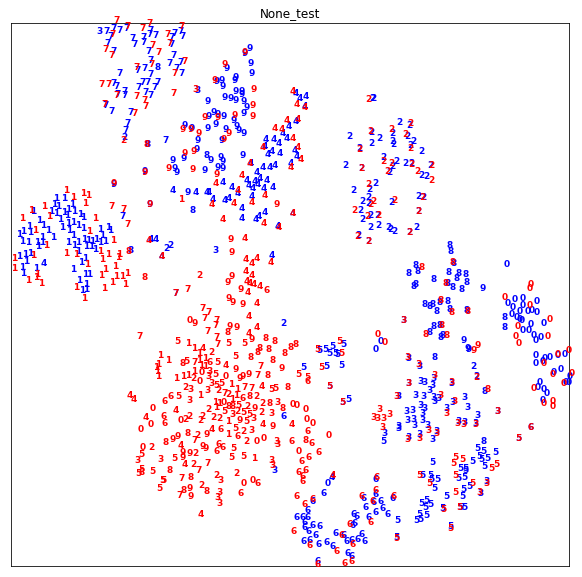

In [13]:
# todo
# todo
from mnistm import *
import model
import torch

def main():
    source_train_loader = mnist.mnist_train_loader
    target_train_loader = mnistm.mnistm_train_loader

    if torch.cuda.is_available():
        print('Running GPU : {}'.format(torch.cuda.current_device()))
        encoder = model.Extractor().cuda()
        classifier = model.Classifier().cuda()
        discriminator = model.Discriminator().cuda()
        encoder.load_state_dict(torch.load('/home/student/Desktop/HW3/trained_models/encoder_source_DANN.pt'))
        visualize(encoder, 'test', 'None')
main()

## Discussions

(1) From the results in Q2, are the both domains closer/farther after performing the transformation? If the answer is closer, it verifies that DABP can learn discriminative and domain invariant features. If not, explain your reasons.

The results in Q2 indicate that the domains are closer after performing the transformation, it suggests that the domain adaptation method (DABP) has been successful in learning discriminative and domain invariant features. When the domains become closer in terms of their feature distributions, it indicates that the transformation has effectively aligned the domains and reduced the gap between them.

(2) List one of the main problems for the DABP method and explain why?

The method uses the labeled target domain data to fine-tune the model after the feature extractor has been trained on the source domain. While fine-tuning can improve the performance on the target domain, it requires access to a substantial amount of labeled target domain data. In some cases, this may not be feasible or may not be cost-effective, especially when the target domain is significantly different from the source domain.

# Problem 3: GAN
In this problem, we will train a generative adversarial network (GAN) to generate new celebrities after showing it pictures of many real celebrities. 

In [14]:
%matplotlib inline

In [15]:
from __future__ import print_function

import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
manualSeed = 999
# manualSeed = random.randint(1, 10000)  # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


### (a) Prepare CelebA Dataset

we will use the [Celeb-A Faces
dataset](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) which can
be downloaded from the [link](https://drive.google.com/file/d/1JgNzlZKQVlVwmlVx-5y6m4Dftbia51YB/view?usp=sharing).
The dataset will download as a file named `img_align_celeba.zip`. Once
downloaded, create a directory named `CelebA` and extract the zip file
into that directory. Then, set the `dataroot` input for this notebook to
the `CelebA` directory you just created. The resulting directory
structure should be:

```
   /path/to/CelebA
       -> img_align_celeba  
           -> 188242.jpg
           -> 173822.jpg
           -> 284702.jpg
           -> 537394.jpg
              ...
```

This is an important step because we will be using the ImageFolder
dataset class, which requires there to be subdirectories in the
dataset’s root folder. 

Here, we upload the data `img_align_celeba.zip` to your Google Drive and mount it to this notebook. Unzip the data as the directory structure introduced above.

In [16]:
!pip install gdown


[notice] A new release of pip is available: 23.0.1 -> 23.1.2
[notice] To update, run: pip install --upgrade pip


In [17]:
import gdown
import zipfile 
import os 

def zip_list(file_path):
    zf = zipfile.ZipFile(file_path, 'r')
    zf.extractall()

url = 'https://drive.google.com/u/0/uc?id=109hS7LvIBAUZZNLX4mmRrtIaXkSbLClc&export=download&confirm=t&uuid=7b8a737c-3c21-4f7e-aa30-1667b44793fb&at=AKKF8vw-daz_oh3kUm6_vP2-6k3d:1683030409048'
output = "img_align_celeba.zip"
gdown.download(url, output)

Downloading...
From: https://drive.google.com/u/0/uc?id=109hS7LvIBAUZZNLX4mmRrtIaXkSbLClc&export=download&confirm=t&uuid=7b8a737c-3c21-4f7e-aa30-1667b44793fb&at=AKKF8vw-daz_oh3kUm6_vP2-6k3d:1683030409048
To: /home/student/Desktop/HW3/Pytorch_DABP/img_align_celeba.zip
100%|██████████| 1.42G/1.42G [01:15<00:00, 18.9MB/s]


'img_align_celeba.zip'

In [18]:
!mkdir ./CelebA
!unzip img_align_celeba.zip -d ./CelebA

Archive:  img_align_celeba.zip
  inflating: ./CelebA/.DS_Store      
   creating: ./CelebA/img_align_celeba/
  inflating: ./CelebA/img_align_celeba/052628.jpg  
  inflating: ./CelebA/img_align_celeba/110369.jpg  
  inflating: ./CelebA/img_align_celeba/161590.jpg  
  inflating: ./CelebA/img_align_celeba/065084.jpg  
  inflating: ./CelebA/img_align_celeba/108526.jpg  
  inflating: ./CelebA/img_align_celeba/045354.jpg  
  inflating: ./CelebA/img_align_celeba/139923.jpg  
  inflating: ./CelebA/img_align_celeba/091663.jpg  
  inflating: ./CelebA/img_align_celeba/107615.jpg  
  inflating: ./CelebA/img_align_celeba/003301.jpg  
  inflating: ./CelebA/img_align_celeba/195377.jpg  
  inflating: ./CelebA/img_align_celeba/150995.jpg  
  inflating: ./CelebA/img_align_celeba/141640.jpg  
  inflating: ./CelebA/img_align_celeba/118735.jpg  
  inflating: ./CelebA/img_align_celeba/126803.jpg  
  inflating: ./CelebA/img_align_celeba/192418.jpg  
  inflating: ./CelebA/img_align_celeba/075297.jpg  
  infla

Set parameters for the implemented network.

In [29]:
# Root directory for dataset
dataroot = "./CelebA"

# Number of workers for dataloader
workers = 16

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

Now, we can create the dataset, create the
dataloader, set the device to run on, and finally visualize some of the
training data.




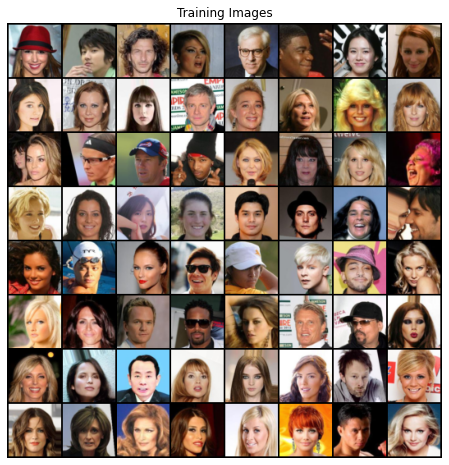

In [30]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

### (b) GAN Implementation

<h4>Weight Initialization</h4>

All model weights in GAN should be randomly initialized from a Normal distribution with `mean = 0`, `stdev = 0.02`. The ``weights_init`` function takes an initialized model as input and reinitializes all convolutional, convolutional-transpose, and batch normalization layers to meet this criteria. This function is applied to the models immediately after initialization.




In [31]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

<h4>Generator</h4>

The generator $G$, is designed to map the latent space vector
$z$ to data-space. Since our data are images, converting
$z$ to data-space means ultimately creating an RGB image with the
same size as the training images (i.e. 3x64x64). In practice, this is
accomplished through a series of strided two dimensional convolutional
transpose layers, each paired with a 2D batch norm layer and a relu
activation. The output of the generator is fed through a tanh function
to return it to the input data range of $[-1,1]$. 




```
Generator(
  (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
  (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU()
  (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (5): ReLU()
  (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (8): ReLU()
  (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (11): ReLU()
  (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (13): Tanh()
)
```

In [32]:
class Generator(nn.Module):
    def __init__(self, nz=100, ngf=64, nc=3):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d(nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        output = self.main(input)
        return output

Now, we can instantiate the generator and apply the ``weights_init``
function. 


In [33]:
# Create the generator
netG = Generator().to(device)

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


<h4>Discriminator</h4>

The discriminator $D$ is a binary classification
network that takes an image as input and outputs a scalar probability
that the input image is real (as opposed to fake). Here, $D$ takes
a 3x64x64 input image, processes it through a series of Conv2d,
BatchNorm2d, and ReLU layers, and outputs the final probability
through a Sigmoid activation function. This architecture can be extended
with more layers if necessary for the problem, but there is significance
to the use of the strided convolution, BatchNorm, and ReLUs. 


```
Discriminator(
  (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (1): ReLU()
  (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (4): ReLU()
  (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (7): ReLU()
  (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (10): ReLU()
  (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
  (12): Sigmoid()
)
```

In [34]:

class Discriminator(nn.Module):
    def __init__(self, in_channels=3, num_filters=64):
        super(Discriminator, self).__init__()
        
        self.net = nn.Sequential(
            nn.Conv2d(in_channels, num_filters, kernel_size=4, stride=2, padding=1, bias=False),
            nn.ReLU(),
            nn.Conv2d(num_filters, num_filters*2, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(num_filters*2),
            nn.ReLU(),
            nn.Conv2d(num_filters*2, num_filters*4, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(num_filters*4),
            nn.ReLU(),
            nn.Conv2d(num_filters*4, num_filters*8, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(num_filters*8),
            nn.ReLU(),
            nn.Conv2d(num_filters*8, 1, kernel_size=4, stride=1, bias=False),
            nn.Sigmoid()
        )
        
    def forward(self, x):
        return self.net(x)

Now, as with the generator, we can create the discriminator, apply the
``weights_init`` function, and print the model’s structure.




In [35]:
# Create the Discriminator
netD = Discriminator().to(device)
    
# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (net): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): ReLU()
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): ReLU()
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): ReLU()
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): ReLU()
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


<h4>Loss Functions and Optimizers</h4>

With $D$ and $G$ setup, we can specify how they learn
through the loss functions and optimizers. We will use the Binary Cross
Entropy loss
([`BCELoss`](https://pytorch.org/docs/stable/nn.html#torch.nn.BCELoss))
function which is defined in PyTorch as:

\begin{align}\ell(x, y) = L = \{l_1,\dots,l_N\}^\top, \quad l_n = - \left[ y_n \cdot \log x_n + (1 - y_n) \cdot \log (1 - x_n) \right]\end{align}

Notice how this function provides the calculation of both log components
in the objective function (i.e. $\log(D(x))$ and
$\log(1-D(G(z)))$). We can specify what part of the BCE equation to
use with the $y$ input. This is accomplished in the training loop
which is coming up soon, but it is important to understand how we can
choose which component we wish to calculate just by changing $y$
(i.e. GT labels).

Next, we define our real label as 1 and the fake label as 0. These
labels will be used when calculating the losses of $D$ and
$G$, and this is also the convention used in the original GAN
paper. Finally, we set up two separate optimizers, one for $D$ and
one for $G$. In the training loop, we will periodically input
this fixed_noise into $G$, and over the iterations we will see
images form out of the noise.




In [36]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [37]:
# Training Loop

num_epochs = 100
# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):
        
        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device) # what does cpu mean?
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()
        
        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
        
        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        
        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
            
        iters += 1

Starting Training Loop...
[0/100][0/1583]	Loss_D: 1.4178	Loss_G: 5.2661	D(x): 0.6662	D(G(z)): 0.5670 / 0.0074
[0/100][50/1583]	Loss_D: 0.1121	Loss_G: 15.2312	D(x): 0.9819	D(G(z)): 0.0746 / 0.0000
[0/100][100/1583]	Loss_D: 0.0151	Loss_G: 12.2162	D(x): 0.9929	D(G(z)): 0.0000 / 0.0000
[0/100][150/1583]	Loss_D: 0.1129	Loss_G: 7.5675	D(x): 0.9213	D(G(z)): 0.0096 / 0.0013
[0/100][200/1583]	Loss_D: 0.5623	Loss_G: 5.9046	D(x): 0.6852	D(G(z)): 0.0149 / 0.0083
[0/100][250/1583]	Loss_D: 0.7725	Loss_G: 4.0880	D(x): 0.6091	D(G(z)): 0.0079 / 0.0285
[0/100][300/1583]	Loss_D: 0.8072	Loss_G: 6.0572	D(x): 0.9855	D(G(z)): 0.4849 / 0.0054
[0/100][350/1583]	Loss_D: 0.8766	Loss_G: 4.5271	D(x): 0.9875	D(G(z)): 0.4797 / 0.0283
[0/100][400/1583]	Loss_D: 0.1277	Loss_G: 6.3186	D(x): 0.9193	D(G(z)): 0.0291 / 0.0067
[0/100][450/1583]	Loss_D: 0.3957	Loss_G: 6.5899	D(x): 0.9376	D(G(z)): 0.2463 / 0.0026
[0/100][500/1583]	Loss_D: 2.4561	Loss_G: 7.5802	D(x): 0.2445	D(G(z)): 0.0003 / 0.0027
[0/100][550/1583]	Loss_D: 0.1

<h4>Training</h4>

Finally, now that we have all of the parts of the GAN framework defined,
we can train it. Be mindful that training GANs is somewhat of an art
form, as incorrect hyperparameter settings lead to mode collapse with
little explanation of what went wrong. Here, we will closely follow
Algorithm 1 from Goodfellow’s paper, while abiding by some of the best
practices shown in [`ganhacks`](https://github.com/soumith/ganhacks).
Namely, we will construct different mini-batches for real and fake
images, and also adjust G’s objective function to maximize
$\log (D(G(z)))$. Training is split up into two main parts. Part 1
updates the Discriminator and Part 2 updates the Generator.

**Part 1: Train the Discriminator**

Recall, the goal of training the discriminator is to maximize the
probability of correctly classifying a given input as real or fake. In
terms of Goodfellow, we wish to “update the discriminator by ascending
its stochastic gradient”. Practically, we want to maximize
$\log(D(x)) + \log(1-D(G(z)))$. Due to the separate mini-batch
suggestion from ganhacks, we will calculate this in two steps. First, we
will construct a batch of real samples from the training set, forward
pass through $D$, calculate the loss ($\log(D(x))$), then
calculate the gradients in a backward pass. Secondly, we will construct
a batch of fake samples with the current generator, forward pass this
batch through $D$, calculate the loss ($\log(1-D(G(z)))$),
and *accumulate* the gradients with a backward pass. Now, with the
gradients accumulated from both the all-real and all-fake batches, we
call a step of the Discriminator’s optimizer.

**Part 2: Train the Generator**

As stated in the original paper, we want to train the Generator by
minimizing $\log(1-D(G(z)))$ in an effort to generate better fakes.
As mentioned, this was shown by Goodfellow to not provide sufficient
gradients, especially early in the learning process. As a fix, we
instead wish to maximize $\log(D(G(z)))$. In the code we accomplish
this by: classifying the Generator output from Part 1 with the
Discriminator, computing G’s loss *using real labels as GT*, computing
G’s gradients in a backward pass, and finally updating G’s parameters
with an optimizer step. It may seem counter-intuitive to use the real
labels as GT labels for the loss function, but this allows us to use the
$\log(x)$ part of the BCELoss (rather than the $\log(1-x)$
part) which is exactly what we want.

Finally, we will do some statistic reporting and at the end of each
epoch we will push our fixed_noise batch through the generator to
visually track the progress of G’s training. The training statistics
reported are:

-  **Loss_D** - discriminator loss calculated as the sum of losses for
   the all real and all fake batches ($\log(D(x)) + \log(D(G(z)))$).
-  **Loss_G** - generator loss calculated as $\log(D(G(z)))$
-  **D(x)** - the average output (across the batch) of the discriminator
   for the all real batch. This should start close to 1 then
   theoretically converge to 0.5 when G gets better. Think about why
   this is.
-  **D(G(z))** - average discriminator outputs for the all fake batch.
   The first number is before D is updated and the second number is
   after D is updated. These numbers should start near 0 and converge to
   0.5 as G gets better. Think about why this is.

**Note:** This step might take a while, depending on how many epochs you
run and if you removed some data from the dataset.




<h4>Visualization</h4>

Finally, lets check out how we did. Here, we will look at three
different results. First, we will see how D and G’s losses changed
during training. Second, we will visualize G’s output on the fixed_noise
batch for every epoch. And third, we will look at a batch of real data
next to a batch of fake data from G.

**Loss versus training iteration**

Below is a plot of D & G’s losses versus training iterations.




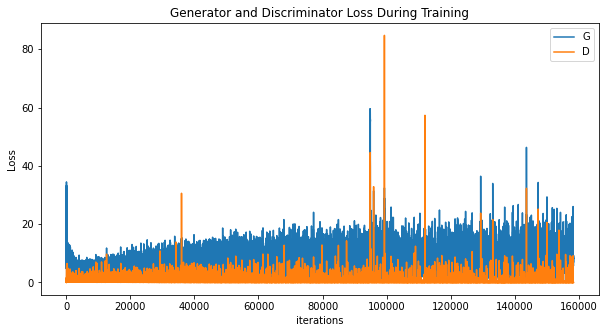

In [38]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

**Visualization of G’s progression**

Remember how we saved the generator’s output on the fixed_noise batch
after every epoch of training. Now, we can visualize the training
progression of G with an animation. Press the play button to start the
animation.




Animation size has reached 21249949 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


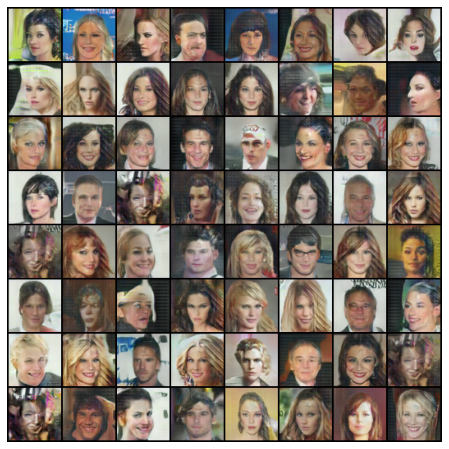

In [39]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

**Real Images vs. Fake Images**

Finally, lets take a look at some real images and fake images side by
side.




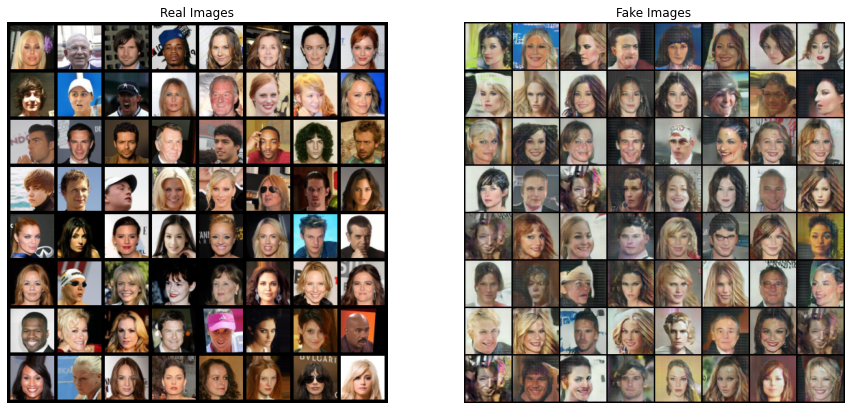

In [40]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

### Change the image size to 128x128. 

Note: Do not overwrite the code for 64x64. Please copy the previous code and do the resizing below.

In [41]:
# todo
# Root directory for dataset
dataroot = "./CelebA"

# Number of workers for dataloader
workers = 16

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 128

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

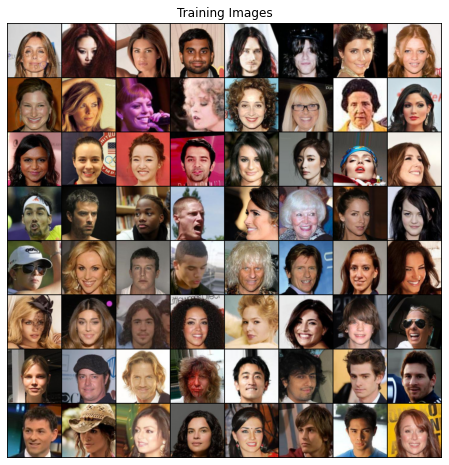

In [42]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [43]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [65]:
class Generator(nn.Module):
    def __init__(self, nz=100, ngf=64, nc=3):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d(nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),

            nn.ConvTranspose2d(ngf * 1, 32, 4, 2, 1, bias=False),
            nn.BatchNorm2d(32),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d(32, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        output = self.main(input)
        return output

In [66]:
netG = Generator().to(device)

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): BatchNorm2d(

In [71]:
class Discriminator(nn.Module):
    def __init__(self, in_channels=3, num_filters=64):
        super(Discriminator, self).__init__()
        
        self.net = nn.Sequential(
            nn.Conv2d(in_channels, num_filters, kernel_size=4, stride=2, padding=1, bias=False),
            nn.ReLU(),
            nn.Conv2d(num_filters, num_filters*2, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(num_filters*2),
            nn.ReLU(),
            nn.Conv2d(num_filters*2, num_filters*4, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(num_filters*4),
            nn.ReLU(),
            nn.Conv2d(num_filters*4, num_filters*8, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(num_filters*8),
            nn.ReLU(),
            nn.Conv2d(num_filters*8, 8, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(8),
            nn.ReLU(),
            nn.Conv2d(8, 1, kernel_size=4, stride=1, bias=True),
            nn.Sigmoid()
        )
        
    def forward(self, x):
        return self.net(x)

In [72]:
# Create the Discriminator
netD = Discriminator().to(device)
    
# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (net): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): ReLU()
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): ReLU()
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): ReLU()
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): ReLU()
    (11): Conv2d(512, 8, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (12): BatchNorm2d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (13): ReLU()
    (14): Conv2d(8, 1, kernel_size=(4, 4), stride=(1, 1))
    (15): Sigmoid()
  )
)

In [73]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [74]:
# Training Loop

num_epochs = 100
# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):
        
        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device) # what does cpu mean?
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()
        
        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
        
        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        
        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
            
        iters += 1

Starting Training Loop...
[0/100][0/1583]	Loss_D: 1.4174	Loss_G: 0.8572	D(x): 0.5439	D(G(z)): 0.5523 / 0.4253
[0/100][50/1583]	Loss_D: 0.4476	Loss_G: 1.4116	D(x): 0.8623	D(G(z)): 0.2575 / 0.2439
[0/100][100/1583]	Loss_D: 0.2658	Loss_G: 1.8251	D(x): 0.9222	D(G(z)): 0.1685 / 0.1613
[0/100][150/1583]	Loss_D: 0.1789	Loss_G: 2.1811	D(x): 0.9488	D(G(z)): 0.1186 / 0.1129
[0/100][200/1583]	Loss_D: 0.1293	Loss_G: 2.4878	D(x): 0.9636	D(G(z)): 0.0881 / 0.0831
[0/100][250/1583]	Loss_D: 0.0947	Loss_G: 2.7603	D(x): 0.9740	D(G(z)): 0.0660 / 0.0633
[0/100][300/1583]	Loss_D: 0.0730	Loss_G: 3.0041	D(x): 0.9804	D(G(z)): 0.0518 / 0.0496
[0/100][350/1583]	Loss_D: 0.0569	Loss_G: 3.2274	D(x): 0.9849	D(G(z)): 0.0409 / 0.0397
[0/100][400/1583]	Loss_D: 0.0458	Loss_G: 3.4313	D(x): 0.9880	D(G(z)): 0.0331 / 0.0323
[0/100][450/1583]	Loss_D: 0.0379	Loss_G: 3.6067	D(x): 0.9904	D(G(z)): 0.0278 / 0.0271
[0/100][500/1583]	Loss_D: 0.0320	Loss_G: 3.7886	D(x): 0.9914	D(G(z)): 0.0231 / 0.0226
[0/100][550/1583]	Loss_D: 0.027

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

In [ ]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

In [ ]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

### (c) Discussions


(1) Why does the training strategy for GAN need to be carefully designed?
The training strategy for GAN needs to be carefully designed because the training process is highly unstable and can easily fail to converge or produce poor quality results if not properly configured. Finding the right balance between the generator and discriminator is essential to avoid issues such as mode collapse, where the generator produces a limited set of samples that the discriminator can easily recognize.



(2) Besides generating fake images from the noise, what other applications can you come up with for GAN?
GANs can be used for various other applications, such as image-to-image translation, data augmentation, and style transfer.